In [121]:
from sys import path
path.append("..")

import numpy as np
import networkx as nx
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from rdd import measures
from rdd import RDD
from rdd import visualize
from rdd import other_sims
from rdd import ascos
from rdd import cos_sim
from numpy.linalg import norm
from itertools import combinations
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from scipy.stats import kstest
from scipy.stats import ks_2samp
import numpy as np
from collections import defaultdict
from itertools import combinations
%matplotlib inline


# imports
from sys import path
path.append("..")
import networkx as nx
from ipywidgets import HBox, VBox, Label, HTML
from rdd import visualize
from rdd import measures
from rdd.visualize import add_markers


# Utility functions
def max_difference(values):
    pairs = combinations(values, 2)
    maximum_difference = -1
    for (i, j) in pairs:
        difference = abs(i-j)
        if difference > maximum_difference:
            maximum_difference = difference
    return maximum_difference


def normalize(values):
    normalized_values = []
    maximum = max(values)
    for i in values:
        normalized_values.append(i / maximum)
    return normalized_values


def normalize2(values, d_min, d_max):
    r_min = min(values)
    r_max = max(values)
    t_min = d_min
    t_max = d_max
    normalized_values = []
    for i in values:
        normalized_values.append(  (i - r_min) / (r_max - r_min) * (t_max - t_min) + t_min)
        print((i - r_min) / (r_max - r_min) * (t_max - t_min) + t_min)
    print("---")
    return normalized_values


def ecdf(data):
    """Compute ECDF for a one-dimensional array of measurements."""
    n = len(data)
    x = np.sort(data)
    y = np.arange(1, n+1) / n
    return x, y


def bin_data(rdd_list, list_of_bins):
    binned = NP.digitize(sorted(rdd_list), bins)
    data_dict = defaultdict(list)
    for bin_number, data_point in zip(binned, sorted(rdd_list)):
        data_dict[bin_number].append(data_point)
    return data_dict


def bin_data_number(rdd_list, number_of_bins):
    binned = pd.qcut(sorted(rdd_list), number_of_bins)
    data_dict = defaultdict(list)
    for bin_number, data_point in zip(binned, sorted(rdd_list)):
        data_dict[str(bin_number)].append(data_point)
    return data_dict


def compare_node_distros(node_list_1, node_list_2):
    print("dissimilar vs similar", ks_2samp(node_list_1, node_list_2))
    fig, axs = plt.subplots(nrows=2)
    x_coord, y_coord = ecdf(node_list_1)
    axs[0].plot(x_coord, y_coord, marker='.', linestyle=":")
    x_coord, y_coord = ecdf(node_list_2)
    axs[1].plot(x_coord, y_coord, marker='.', linestyle=":")


# G = nx.read_gml('../data/karate.gml', label='id')
# pos = nx.spring_layout(G)
# blank = visualize.draw(G)
# blank.show()

# Read the facebook graph
G = nx.read_adjlist('../data/facebook_combined.txt', nodetype=int)

dissimilar vs similar KstestResult(statistic=0.6301369863013698, pvalue=0.027009121745963927)


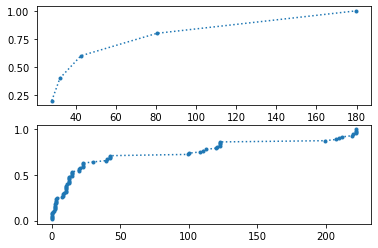

In [122]:
compare_node_distros(similar_nodes_rdd[:5], similar_nodes_rdd[5:])

# Gets RDD starting from each node being set as the root node. (There is no consistent root node.)

In [73]:
# # These are all randos from the same community but different degrees (9, 1, 24, 17, 3)
# similar = [33, 34, 1, 3]
# similar2 = [16, 21, 15, 23]

# # all degree 2 but totally different structurally
# # dissimilar = [10, 17, 1, 28]
# dissimilar = [27, 19]

# similar_rdds = []
# dissimilar_rdds = []

# These are all randos from the same community but different degrees (9, 1, 24, 17, 3)
similar = [3580, 3853, 3956, 3960, 3801, 3699, 3875, 3935, 3746, 3798, 3650, 3816, 3965]


# all degree 2 but totally different structurally
dissimilar = [1967, 3922, 42, 1394, 3407, 2641, 3290, 269, 166, 344, 1890, 1910, 4037, 4035, 851]


def compare_community(nodes):
    rdd_list = []
    for u, v in combinations(nodes, 2):
        rd = measures.realworld_distance_compare(G, u, v, measures.global_graph_degree, 2)
        rdd_list.append(rd)
        print(f"{u} and {v} rdd: {rd}")
    print("normalized value of RDDs:", norm(rdd_list))
    return rdd_list

similar_nodes_rdd = compare_community(similar)
# similar_nodes2 = compare_community(similar2)
dissimilar_nodes_rdd = compare_community(dissimilar)

# print(max_difference(similar_nodes))
# print(max_difference(dissimilar_nodes))

3580 and 3853 rdd: 42.58066747011558
3580 and 3956 rdd: 179.80998964480617
3580 and 3960 rdd: 80.47224991077414
3580 and 3801 rdd: 28.07276647028654
3580 and 3699 rdd: 32.119440323172405
3580 and 3875 rdd: 39.37339082308692
3580 and 3935 rdd: 42.58066747011558
3580 and 3746 rdd: 40.477029146601254
3580 and 3798 rdd: 42.58066747011558
3580 and 3650 rdd: 42.58066747011558
3580 and 3816 rdd: 30.280043117315195
3580 and 3965 rdd: 19.715177646857693
3853 and 3956 rdd: 222.39065711492174
3853 and 3960 rdd: 123.05291738088972
3853 and 3801 rdd: 14.50790099982904
3853 and 3699 rdd: 10.461227146943173
3853 and 3875 rdd: 3.207276647028654
3853 and 3935 rdd: 0.0
3853 and 3746 rdd: 2.103638323514327
3853 and 3798 rdd: 0.0
3853 and 3650 rdd: 0.0
3853 and 3816 rdd: 12.300624352800385
3853 and 3965 rdd: 22.865489823257885
3956 and 3960 rdd: 99.33773973403203
3956 and 3801 rdd: 207.88275611509272
3956 and 3699 rdd: 211.92942996797856
3956 and 3875 rdd: 219.1833804678931
3956 and 3935 rdd: 222.39065711

# This is comparing each node to each other, pairwise, setting the root node to one of the nodes each time.

In [5]:
# If the KS statistic is small or the p-value is high, then we cannot
# reject the hypothesis that the distributions of the two samples
# are the same.

# our hypothesis: the distributions of the them are the same
# our P-value is high-->  ^^ this is probably true

print("similar vs dissimilar", ks_2samp(similar_nodes, dissimilar_nodes))
print("first half of similar vs second half of similar", ks_2samp(similar_nodes[0:15], similar_nodes[15:]))
print("first half of dissimilar vs second half of dissimilar", ks_2samp(dissimilar_nodes[0:5], dissimilar_nodes[5:10]))

similar vs dissimilar KstestResult(statistic=0.9714285714285714, pvalue=6.576093809713719e-70)
first half of similar vs second half of similar KstestResult(statistic=0.5650793650793651, pvalue=0.0003955856809501057)
first half of dissimilar vs second half of dissimilar KstestResult(statistic=0.4, pvalue=0.873015873015873)


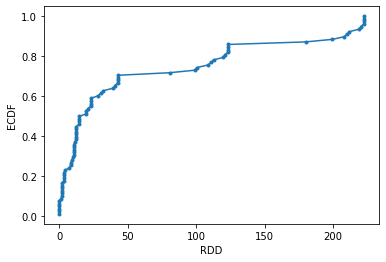

In [6]:
x_coord, y_coord = ecdf(similar_nodes)
plt.plot(x_coord, y_coord, marker='.', linestyle='-')
# plt.margins(0.02)
plt.xlabel('RDD')
plt.ylabel('ECDF')
plt.show()

first half of similar vs second half of similar KstestResult(statistic=0.5650793650793651, pvalue=0.0003955856809501057)


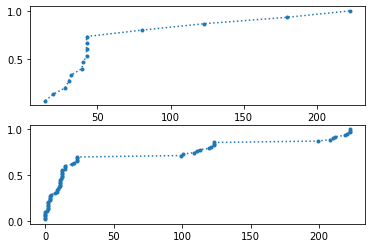

In [7]:
print("first half of similar vs second half of similar", ks_2samp(similar_nodes[0:15], similar_nodes[15:]))

fig, axs = plt.subplots(nrows=2)
# fig.suptitle('Vertically stacked subplots')
x_coord, y_coord = ecdf(similar_nodes[0:15])
axs[0].plot(x_coord, y_coord, marker='.', linestyle=":")
x_coord, y_coord = ecdf(similar_nodes[15:])
axs[1].plot(x_coord, y_coord, marker='.', linestyle=":")

similar vs dissimilar KstestResult(statistic=0.9714285714285714, pvalue=6.576093809713719e-70)


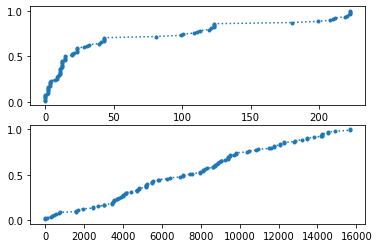

In [8]:
print("similar vs dissimilar", ks_2samp(similar_nodes, dissimilar_nodes))

fig, axs = plt.subplots(nrows=2)
# fig.suptitle('Vertically stacked subplots')
x_coord, y_coord = ecdf(similar_nodes)
axs[0].plot(x_coord, y_coord, marker='.', linestyle=":")
x_coord, y_coord = ecdf(dissimilar_nodes)
axs[1].plot(x_coord, y_coord, marker='.', linestyle=":")

first half of dissimilar vs second half of dissimilar KstestResult(statistic=0.4, pvalue=0.873015873015873)


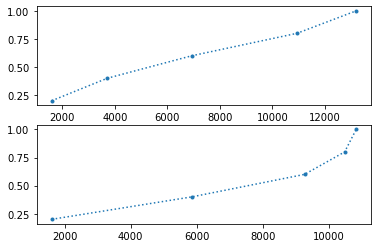

In [9]:
print("first half of dissimilar vs second half of dissimilar", ks_2samp(dissimilar_nodes[0:5], dissimilar_nodes[5:10]))

fig, axs = plt.subplots(nrows=2)
# fig.suptitle('Vertically stacked subplots')
x_coord, y_coord = ecdf(dissimilar_nodes[0:5])
axs[0].plot(x_coord, y_coord, marker='.', linestyle=':')
x_coord, y_coord = ecdf(dissimilar_nodes[5:10])
axs[1].plot(x_coord, y_coord, marker='.', linestyle=":")

# Compare each node to one constant root node (0).

In [10]:
# These are all randos from the same community but different degrees (9, 1, 24, 17, 3)
similar = [3580, 3853, 3956, 3960, 3801, 3699, 3875, 3935, 3746, 3798, 3650, 3816, 3965]

# all degree 2 but totally different structurally
dissimilar = [1967, 3922, 42, 1394, 3407]


def compare_community(nodes):
    rdd_list = []
    for i in nodes:
        rd = measures.realworld_distance_compare(G, 0, i, measures.global_graph_degree, 3)
        rdd_list.append(rd)
        print(f"{i} {rd}")
    print("normalized value of RDDs:", norm(rdd_list))
    return rdd_list

similar_nodes = compare_community(similar)
dissimilar_nodes = compare_community(dissimilar)

3580 18650.909298814884
3853 18693.489966285
3956 18471.099309170077
3960 18570.43704890411
3801 18678.98206528517
3699 18683.028739138055
3875 18690.28268963797
3935 18693.489966285
3746 18691.386327961485
3798 18693.489966285
3650 18693.489966285
3816 18681.1893419322
3965 18670.62447646174
normalized value of RDDs: 67274.95005825057
1967 5494.23717689684
3922 18688.075412990944
42 16432.790871739686
1394 6937.761408650265
3407 12421.027003593295
normalized value of RDDs: 29187.0153633309


In [11]:
# If the KS statistic is small or the p-value is high, then we cannot
# reject the hypothesis that the distributions of the two samples
# are the same.

# our hypothesis: the distributions of the them are the same
# our P-value is high-->  ^^ this is probably true

print("similar vs dissimilar", ks_2samp(similar_nodes, dissimilar_nodes))
print("first half of similar vs second half of similar", ks_2samp(similar_nodes[0:6], similar_nodes[6:]))
print("first half of dissimilar vs second half of dissimilar", ks_2samp(dissimilar_nodes[0:2], dissimilar_nodes[2:]))

similar vs dissimilar KstestResult(statistic=0.8, pvalue=0.007469654528478031)
first half of similar vs second half of similar KstestResult(statistic=0.5476190476190477, pvalue=0.21212121212121204)
first half of dissimilar vs second half of dissimilar KstestResult(statistic=0.5, pvalue=0.9)


In [12]:
for i in range(len(similar_nodes)):
    remaining_values = similar_nodes.copy()
    value = remaining_values.pop(i)
    print(ks_2samp([value], remaining_values))

KstestResult(statistic=0.8333333333333334, pvalue=0.46153846153846156)
KstestResult(statistic=0.75, pvalue=0.6153846153846154)
KstestResult(statistic=1.0, pvalue=0.15384615384615385)
KstestResult(statistic=0.9166666666666666, pvalue=0.3076923076923077)
KstestResult(statistic=0.6666666666666666, pvalue=0.7692307692307692)
KstestResult(statistic=0.5, pvalue=1)
KstestResult(statistic=0.5833333333333334, pvalue=0.9230769230769231)
KstestResult(statistic=0.75, pvalue=0.6153846153846154)
KstestResult(statistic=0.6666666666666666, pvalue=0.7692307692307692)
KstestResult(statistic=0.75, pvalue=0.6153846153846154)
KstestResult(statistic=0.75, pvalue=0.6153846153846154)
KstestResult(statistic=0.5833333333333334, pvalue=0.9230769230769231)
KstestResult(statistic=0.75, pvalue=0.6153846153846154)


first half of similar vs second half of similar KstestResult(statistic=0.5476190476190477, pvalue=0.21212121212121204)


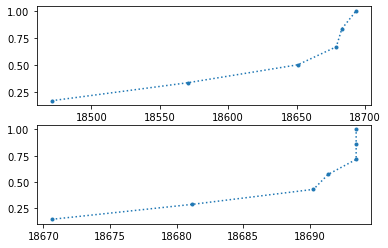

In [13]:
print("first half of similar vs second half of similar", ks_2samp(similar_nodes[0:6], similar_nodes[6:]))

fig, axs = plt.subplots(nrows=2)
# fig.suptitle('Vertically stacked subplots')
x_coord, y_coord = ecdf(similar_nodes[0:6])
axs[0].plot(x_coord, y_coord, marker='.', linestyle=":")
x_coord, y_coord = ecdf(similar_nodes[6:])
axs[1].plot(x_coord, y_coord, marker='.', linestyle=":")

similar vs dissimilar KstestResult(statistic=0.8, pvalue=0.007469654528478031)


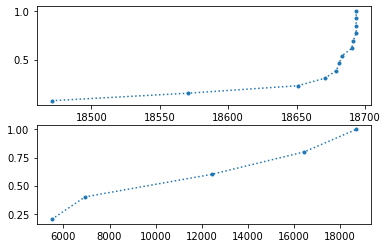

In [14]:
print("similar vs dissimilar", ks_2samp(similar_nodes, dissimilar_nodes))

fig, axs = plt.subplots(nrows=2)
# fig.suptitle('Vertically stacked subplots')
x_coord, y_coord = ecdf(similar_nodes)
axs[0].plot(x_coord, y_coord, marker='.', linestyle=":")
x_coord, y_coord = ecdf(dissimilar_nodes)
axs[1].plot(x_coord, y_coord, marker='.', linestyle=":")

first half of dissimilar vs second half of dissimilar KstestResult(statistic=0.5, pvalue=0.9)


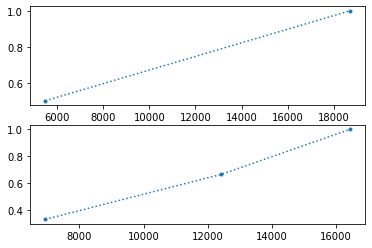

In [15]:
print("first half of dissimilar vs second half of dissimilar", ks_2samp(dissimilar_nodes[0:2], dissimilar_nodes[2:]))

fig, axs = plt.subplots(nrows=2)
# fig.suptitle('Vertically stacked subplots')
x_coord, y_coord = ecdf(dissimilar_nodes[0:2])
axs[0].plot(x_coord, y_coord, marker='.', linestyle=':')
x_coord, y_coord = ecdf(dissimilar_nodes[2:])
axs[1].plot(x_coord, y_coord, marker='.', linestyle=":")

In [19]:
similar = [3580, 3853, 3956, 3960, 3801, 3699, 3875, 3935, 3746, 3798, 3650, 3816, 3965]
def compare_community(nodes):
    rdd_list = []
    for i in nodes:
#         rd = measures.realworld_distance_compare(G, 0, i, measures.global_graph_degree, 3)
        rd = ascos.get_ascos_radius(G, i, 2)
        rdd_list.append(rd)
        print(f"{i} {rd}")
#     print("normalized value of RDDs:", norm(rdd_list))
    return rdd_list

similar_nodes = compare_community(similar)
dissimilar_nodes = compare_community(dissimilar)

3580      node_name  degree     ascos
0          567      63  0.634705
1          698      68  0.220641
2          857      12  0.567933
3          862      24  0.873613
4         1085      66  1.013000
..         ...     ...       ...
543       3975      15  0.779153
544       3976      15  0.781659
545       3977       6  0.427635
546       3978       4  0.290648
547       3979      12  0.701647

[548 rows x 3 columns]
3853      node_name  degree     ascos
0          567      63  0.702568
1          698      68  0.348060
2          857      12  0.776795
3          862      24  1.114055
4         1085      66  1.259464
..         ...     ...       ...
543       3975      15  1.015042
544       3976      15  0.959333
545       3977       6  0.616431
546       3978       4  0.438840
547       3979      12  0.926364

[548 rows x 3 columns]
3956      node_name  degree     ascos
0          567      63  0.527430
1          698      68  0.175277
2          857      12  0.485763
3          86

KeyboardInterrupt: 

In [97]:
similar = [3580, 3853, 3956, 3960, 3801, 3699, 3875, 3935, 3746, 3798, 3650, 3816, 3965]
rd = ascos.get_ascos(G, 0)


In [98]:
rd

,node_name,degree,ascos
0,0,347,3.000000
1,1,17,1.365651
2,2,10,1.265021
3,3,17,1.349450
4,4,10,1.242741
...,...,...,...
4034,4034,2,0.000363
4035,4035,1,0.000213
4036,4036,2,0.000315
4037,4037,4,0.000621


In [39]:
similar_nodes[0][['node_name', 'ascos']]

,node_name,ascos
0,567,0.634705
1,698,0.220641
2,857,0.567933
3,862,0.873613
4,1085,1.013000
...,...,...
543,3975,0.779153
544,3976,0.781659
545,3977,0.427635
546,3978,0.290648


In [48]:
df1 = similar_nodes[0]

similar vs similar KstestResult(statistic=0.4, pvalue=0.5858585858585859)


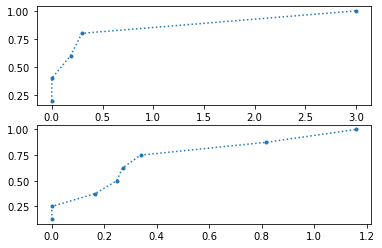

In [107]:
similar_vals = df1[   df1['node_name'].isin(similar)   ]['ascos'].values

print("similar vs similar", ks_2samp(similar_vals[0:5], similar_vals[5:]))

fig, axs = plt.subplots(nrows=2)
# fig.suptitle('Vertically stacked subplots')
x_coord, y_coord = ecdf(similar_vals[0:5])
axs[0].plot(x_coord, y_coord, marker='.', linestyle=":")
x_coord, y_coord = ecdf(similar_vals[5:])
axs[1].plot(x_coord, y_coord, marker='.', linestyle=":")

similar vs similar KstestResult(statistic=0.25, pvalue=0.9627039627039627)


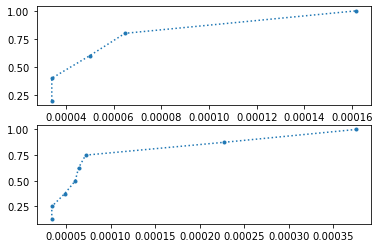

In [124]:
similar_vals = rd[   rd['node_name'].isin(similar)   ]['ascos'].values

print("similar vs similar", ks_2samp(similar_vals[0:5], similar_vals[5:]))

fig, axs = plt.subplots(nrows=2)
# fig.suptitle('Vertically stacked subplots')
x_coord, y_coord = ecdf(similar_vals[0:5])
axs[0].plot(x_coord, y_coord, marker='.', linestyle=":")
x_coord, y_coord = ecdf(similar_vals[5:])
axs[1].plot(x_coord, y_coord, marker='.', linestyle=":")

In [102]:
similar_vals

array([1.61680311e-04, 3.40787207e-05, 6.47749454e-05, 4.99292508e-05,
       3.40787207e-05, 6.40589412e-05, 6.04159327e-05, 3.40787207e-05,
       4.86080231e-05, 3.40787207e-05, 3.75419015e-04, 2.27376642e-04,
       7.20232964e-05])

In [101]:
rd

,node_name,degree,ascos
0,0,347,3.000000
1,1,17,1.365651
2,2,10,1.265021
3,3,17,1.349450
4,4,10,1.242741
...,...,...,...
4034,4034,2,0.000363
4035,4035,1,0.000213
4036,4036,2,0.000315
4037,4037,4,0.000621


dissimilar vs similar KstestResult(statistic=0.358974358974359, pvalue=0.25431374685648456)


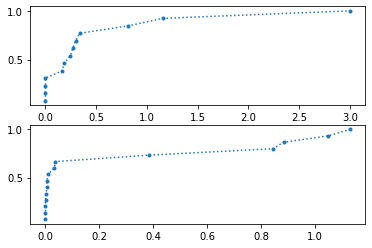

In [123]:
dissimilar_vals = rd[   rd['node_name'].   isin(dissimilar)   ]['ascos'].values

print("dissimilar vs similar", ks_2samp(similar_vals, dissimilar_vals))

fig, axs = plt.subplots(nrows=2)
x_coord, y_coord = ecdf(similar_vals)
axs[0].plot(x_coord, y_coord, marker='.', linestyle=":")
x_coord, y_coord = ecdf(dissimilar_vals)
axs[1].plot(x_coord, y_coord, marker='.', linestyle=":")

In [112]:
ks_2samp(similar_nodes_rdd, dissimilar_nodes_rdd)

KstestResult(statistic=0.9428571428571428, pvalue=2.3137579821912223e-56)

In [117]:
ks_2samp(similar_nodes_rdd[0:40], dissimilar_nodes_rdd[40:])

KstestResult(statistic=0.9384615384615385, pvalue=1.1102230246251565e-16)

In [114]:
len(similar_nodes_rdd)

78